In [ ]:
!pip install ultralytics opencv-python matplotlib pyyaml

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 914.9/914.9 kB 27.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 104.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 85.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 44.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 63.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
import requests
import zipfile
import os

def download_file(url, save_name):
    if not os.path.exists(save_name):
        file = requests.get(url)
        open(save_name, 'wb').write(file.content)

download_file('https://www.dropbox.com/s/ievh0sesad015z0/trash_inst_material.zip?dl=1', 'trash_inst_material.zip')

def unzip(zip_file):
    with zipfile.ZipFile(zip_file, 'r') as z:
        z.extractall("./")
        print(f"Extracted {zip_file}")

unzip('trash_inst_material.zip')


Extracted trash_inst_material.zip


In [ ]:
import yaml
import os

cwd = os.getcwd()

dataset_config = {
    'path': cwd + '/trash_inst_material',
    'train': 'train/images',
    'val': 'val/images',
    'names': {
        0: 'rov',
        1: 'plant',
        2: 'animal_fish',
        3: 'animal_starfish',
        4: 'animal_shells',
        5: 'animal_crab',
        6: 'animal_eel',
        7: 'animal_etc',
        8: 'trash_etc',
        9: 'trash_fabric',
        10: 'trash_fishing_gear',
        11: 'trash_metal',
        12: 'trash_paper',
        13: 'trash_plastic',
        14: 'trash_rubber',
        15: 'trash_wood'
    }
}



print("Dataset configuration saved as trashcan_inst_material.yaml")


Dataset configuration saved as trashcan_inst_material.yaml


In [6]:
!yolo task=segment mode=train model=yolov8s-seg.pt imgsz=640 data=trashcan_inst_material.yaml \
  epochs=10 batch=8 name=yolov8s-seg exist_ok=True amp=True device=0


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
100% 22.8M/22.8M [00:00<00:00, 201MB/s]
Ultralytics 8.3.75 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=segment, mode=train, model=yolov8s-seg.pt, data=trashcan_inst_material.yaml, epochs=10, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=yolov8s-seg, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, 

In [7]:
download_file('https://www.dropbox.com/s/smdsotzz5al3bi2/trash_segment_inference_data.zip?dl=1', 'trash_segment_inference_data.zip')
unzip('trash_segment_inference_data.zip')


Extracted trash_segment_inference_data.zip


In [ ]:
!yolo predict model='runs/segment/yolov8s-seg/weights/best.pt' source='trash_inst_material/val/images/' \
  name='yolov8s_predict' exist_ok=True save=True


Ultralytics 8.3.75 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8s-seg summary (fused): 195 layers, 11,785,792 parameters, 0 gradients, 42.5 GFLOPs

image 1/1204 /content/trash_inst_material/val/images/vid_000002_frame0000013.jpg: 384x640 1 trash_etc, 50.0ms
image 2/1204 /content/trash_inst_material/val/images/vid_000002_frame0000014.jpg: 384x640 1 trash_etc, 14.0ms
image 3/1204 /content/trash_inst_material/val/images/vid_000002_frame0000015.jpg: 384x640 1 trash_etc, 13.8ms
image 4/1204 /content/trash_inst_material/val/images/vid_000002_frame0000016.jpg: 384x640 1 trash_etc, 13.7ms
image 5/1204 /content/trash_inst_material/val/images/vid_000002_frame0000017.jpg: 384x640 1 trash_etc, 13.7ms
image 6/1204 /content/trash_inst_material/val/images/vid_000002_frame0000018.jpg: 384x640 1 trash_etc, 13.7ms
image 7/1204 /content/trash_inst_material/val/images/vid_000002_frame0000019.jpg: 384x640 1 trash_etc, 13.7ms
image 8/1204 /content/trash_inst_material/val/images/vid_0

In [9]:
!yolo predict model='runs/segment/yolov8s-seg/weights/best.pt' source='trash_segment_inference_data/manythings.mp4' \
  name='yolov8s_predict_videos' exist_ok=True save=True


Ultralytics 8.3.75 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8s-seg summary (fused): 195 layers, 11,785,792 parameters, 0 gradients, 42.5 GFLOPs

video 1/1 (frame 1/1168) /content/trash_segment_inference_data/manythings.mp4: 480x640 (no detections), 47.9ms
video 1/1 (frame 2/1168) /content/trash_segment_inference_data/manythings.mp4: 480x640 (no detections), 16.8ms
video 1/1 (frame 3/1168) /content/trash_segment_inference_data/manythings.mp4: 480x640 1 trash_etc, 1 trash_plastic, 16.7ms
video 1/1 (frame 4/1168) /content/trash_segment_inference_data/manythings.mp4: 480x640 1 trash_etc, 1 trash_plastic, 16.9ms
video 1/1 (frame 5/1168) /content/trash_segment_inference_data/manythings.mp4: 480x640 1 trash_etc, 1 trash_plastic, 16.8ms
video 1/1 (frame 6/1168) /content/trash_segment_inference_data/manythings.mp4: 480x640 1 trash_etc, 1 trash_plastic, 19.3ms
video 1/1 (frame 7/1168) /content/trash_segment_inference_data/manythings.mp4: 480x640 1 trash_etc, 1 trash_pl

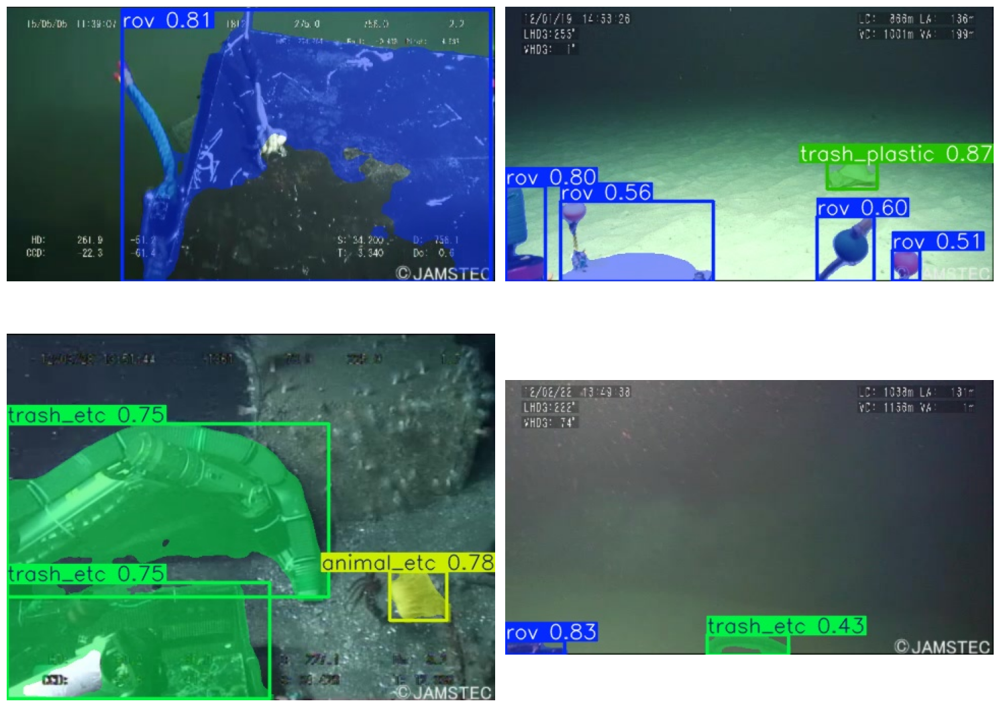

In [10]:
import glob
import matplotlib.pyplot as plt

def visualize(result_dir):
    image_names = glob.glob(os.path.join(result_dir, '*.jpg'))
    plt.figure(figsize=(15, 12))

    for i, image_name in enumerate(image_names[:4]):
        image = plt.imread(image_name)
        plt.subplot(2, 2, i+1)
        plt.imshow(image)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

visualize('runs/segment/yolov8s_predict')


In [11]:
!ffmpeg -i runs/segment/yolov8s_predict_videos/manythings.avi -vcodec libx264 \
  runs/segment/yolov8s_predict_videos/manythings.mp4


ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [12]:
import IPython
from IPython.display import display

video_path = "runs/segment/yolov8s_predict_videos/manythings.mp4"
display(IPython.display.Video(video_path))



In [13]:
!ffmpeg -i runs/segment/yolov8s_predict_videos/manythings.mp4 -vf "scale=640:-1" -r 30 \
  -vcodec libx264 -pix_fmt yuv420p runs/segment/yolov8s_predict_videos/manythings_final.mp4


ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [14]:
video_path = "runs/segment/yolov8s_predict_videos/manythings_final.mp4"
display(IPython.display.Video(video_path))


In [15]:
from google.colab import files
files.download("runs/segment/yolov8s_predict_videos/manythings_final.mp4")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [16]:
import cv2
import glob
import os
from ultralytics import YOLO

# Load YOLOv8 model
model = YOLO("/content/runs/segment/yolov8s-seg/weights/best.pt")  # Replace with your trained model path

# Input and output directories
input_folder = "/content/trash_inst_material/val/images"  # Folder containing frames
output_folder = "/content/frames_output/"  # Output folder for processed frames
os.makedirs(output_folder, exist_ok=True)

# Get all image files
image_files = sorted(glob.glob(input_folder + "*.jpg"))  # Change extension if needed

# Process each frame
for img_path in image_files:
    results = model(img_path)  # Run YOLO inference
    output_path = os.path.join(output_folder, os.path.basename(img_path))  # Save path
    results[0].save(filename=output_path)  # Save the detected frame


In [18]:
import os

input_folder = "/content/trash_inst_material/val/images/"  # Make sure this path is correct

if not os.path.exists(input_folder):
    print(f"Error: The folder '{input_folder}' does not exist!")

# List files in the directory
files = os.listdir(input_folder)
print("Files in folder:", files)


Files in folder: ['vid_000074_frame0000051.jpg', 'vid_000122_frame0000058.jpg', 'vid_000150_frame0000016.jpg', 'vid_000131_frame0000022.jpg', 'vid_000082_frame0000010.jpg', 'vid_000122_frame0000056.jpg', 'vid_000003_frame0000018.jpg', 'vid_000028_frame0000013.jpg', 'vid_000030_frame0000013.jpg', 'vid_000078_frame0000003.jpg', 'vid_000021_frame0000022.jpg', 'vid_000140_frame0000035.jpg', 'vid_000112_frame0000011.jpg', 'vid_000045_frame0000008.jpg', 'vid_000085_frame0000037.jpg', 'vid_000212_frame0000014.jpg', 'vid_000108_frame0000030.jpg', 'vid_000111_frame0000009.jpg', 'vid_000116_frame0000006.jpg', 'vid_000122_frame0000010.jpg', 'vid_000039_frame0000018.jpg', 'vid_000234_frame0000011.jpg', 'vid_000086_frame0000079.jpg', 'vid_000002_frame0000017.jpg', 'vid_000027_frame0000049.jpg', 'vid_000146_frame0000001.jpg', 'vid_000045_frame0000062.jpg', 'vid_000045_frame0000007.jpg', 'vid_000119_frame0000007.jpg', 'vid_000086_frame0000019.jpg', 'vid_000030_frame0000012.jpg', 'vid_000031_frame0000

In [19]:
import glob
import cv2

input_folder = "/content/trash_inst_material/val/images/"  # Ensure this path is correct
image_files = sorted(glob.glob(input_folder + "*.jpg"))  # Adjust extension if needed

# Check if any images are found
if len(image_files) == 0:
    print("No images found! Check folder path or file formats.")
else:
    print(f"Found {len(image_files)} images.")

    # Read the first image safely
    frame = cv2.imread(image_files[0])

    if frame is None:
        print(f"Error: Unable to read {image_files[0]}. Check the file format or corruption.")
    else:
        height, width, _ = frame.shape
        print(f"Frame size: {width}x{height}")


Found 1204 images.
Frame size: 480x270


In [20]:
from ultralytics import YOLO
import cv2
import os
import glob

# Load the YOLOv8 model (change 'yolov8n.pt' to your model)
model = YOLO("/content/runs/segment/yolov8s-seg/weights/best.pt")
  # Use 'best.pt' if you trained a custom model

# Define input folder containing images
input_folder = "/content/trash_inst_material/val/images/"  # Change this to your folder path
output_folder = "/content/output_frames"
os.makedirs(output_folder, exist_ok=True)

# Get all image paths
image_files = sorted(glob.glob(os.path.join(input_folder, "*.jpg")))

# Run inference on each frame
for image_path in image_files:
    frame = cv2.imread(image_path)
    results = model(frame)  # Perform inference

    # Draw bounding boxes on the image
    for result in results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get box coordinates
            conf = box.conf[0].item()  # Confidence score
            cls = int(box.cls[0].item())  # Class label
            label = f"{model.names[cls]} {conf:.2f}"

            # Draw box and label on the frame
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Save the output frame
    output_path = os.path.join(output_folder, os.path.basename(image_path))
    cv2.imwrite(output_path, frame)

print("Predictions saved to:", output_folder)



0: 384x640 1 trash_etc, 52.0ms
Speed: 5.2ms preprocess, 52.0ms inference, 150.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 trash_etc, 13.8ms
Speed: 3.1ms preprocess, 13.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 trash_etc, 13.8ms
Speed: 2.9ms preprocess, 13.8ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 trash_etc, 13.7ms
Speed: 3.1ms preprocess, 13.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 trash_etc, 13.7ms
Speed: 2.0ms preprocess, 13.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 trash_etc, 16.1ms
Speed: 2.3ms preprocess, 16.1ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 trash_etc, 14.5ms
Speed: 2.4ms preprocess, 14.5ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 trash_etc, 1 trash_plastic, 16.2ms
Speed: 2.5ms preprocess, 16.2ms inference, 2.7

In [21]:
import cv2
import glob

output_video = "/content/predicted_video.mp4"
fps = 30  # Adjust FPS if needed

# Get image files (make sure they are sorted correctly)
image_files = sorted(glob.glob(os.path.join(output_folder, "*.jpg")))

# Read the first frame to get size
frame = cv2.imread(image_files[0])
height, width, _ = frame.shape

# Initialize video writer
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
video_writer = cv2.VideoWriter(output_video, fourcc, fps, (width, height))

# Write each frame
for image_path in image_files:
    frame = cv2.imread(image_path)
    video_writer.write(frame)

video_writer.release()
print(f"Video saved as: {output_video}")


Video saved as: /content/predicted_video.mp4


In [22]:
from IPython.display import display, HTML

video_path = "/content/predicted_video.mp4"

# Display the video in Colab
display(HTML(f"""
    <video width="640" height="360" controls>
        <source src="{video_path}" type="video/mp4">
    </video>
"""))


In [27]:
import cv2

video_path = "/content/predicted_video.mp4"
cap = cv2.VideoCapture(video_path)

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    cv2.imshow("Predicted Video", frame)
    if cv2.waitKey(25) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()


DisabledFunctionError: cv2.imshow() is disabled in Colab, because it causes Jupyter sessions
to crash; see https://github.com/jupyter/notebook/issues/3935.
As a substitution, consider using
  from google.colab.patches import cv2_imshow


In [28]:
from IPython.display import Video

video_path = "/content/predicted_video.mp4"
Video(video_path, embed=True)


In [29]:
from google.colab import files

video_path = "/content/predicted_video.mp4"
files.download(video_path)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


0: 384x640 1 trash_etc, 15.3ms
Speed: 1.9ms preprocess, 15.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


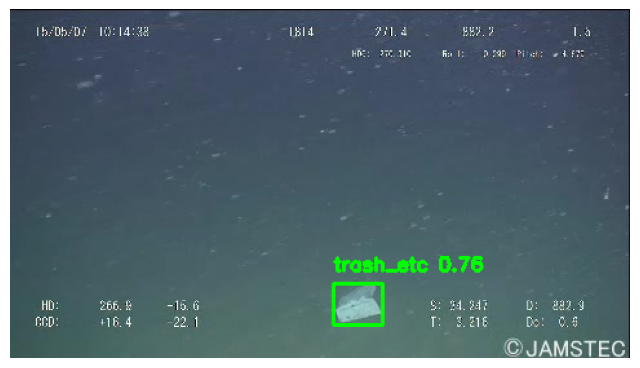

In [33]:
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt

# Load the YOLOv8 model
model = YOLO("/content/drive/MyDrive/Best_model/best.pt")  # Change path if needed

# Define the image path
image_path = "/content/drive/MyDrive/trash_inst_material/val/images/vid_000003_frame0000021.jpg"

# Read the image
frame = cv2.imread(image_path)
frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for correct color display

# Perform inference
results = model(frame)

# Draw bounding boxes on the image
for result in results:
    for box in result.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Get box coordinates
        conf = box.conf[0].item()  # Confidence score
        cls = int(box.cls[0].item())  # Class label
        label = f"{model.names[cls]} {conf:.2f}"

        # Draw box and label
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Display the image
plt.figure(figsize=(8, 6))
plt.imshow(frame)
plt.axis("off")
plt.show()
